<div style="text-align: center; background-color: #f2f2f2aa; padding: 10px; color: #111; border: 4px solid #333">
  <h1>SI 221-B</h1>
  <h3>Bases de l’Apprentissage</h3>
  <h3>TP "PCA & K-means"</h3>
  <h4>MARTINS BRAGA Arthur</h4>
</div>

### Données

Nous allons travailler sur des images satellitaire: celles-ci sont capturées via différent capteurs, chacun correspondant à un domaine de longueur d'ondes. Nous avons donc, pour chaque image, un certain nombre de *canaux* - chacun correspondant à un *domaine spectral*. 

- Données SPOT sur Tarascon: La taille du pixel est de 20m. Il y a 3 canaux: 
    - 0.50-0.59 $\mu$
    - 0.61-0.68 $\mu$
    - 0.78-0.89 $\mu$
    
- Données LANDSAT sur Tarascon: La taille du pixel est de 30m. Il y a 8 canaux:
    - 0.45-0.52 $\mu$       
    - 0.52-0.60 $\mu$     
    - 0.63-0.69 $\mu$
    - 0.75-0.90 $\mu$ (Proche InfraRouge : PIR)     
    - 2.08-2.35 $\mu$ (Moyen InfraRouge : MIR)    
    - 10.40-12.50 $\mu$ (infra rouge thermique)      
    - 1.55-1.75 $\mu$ (Moyen InfraRouge : MIR)     
    - 0.52-0.90 $\mu$ (panchromatique)   
    
- Données LANDSAT sur Kedougou: La taille du pixel est de 30m; mais, à la différence des données acquises sur Tarascon, il y a un problème d’acquisition de données inhérent au capteur. Il y a ici 6 canaux:
    - 0.45-0.52 $\mu$
    - 0.52-0.60 $\mu$
    - 0.63-0.69 $\mu$
    - 0.76-0.90 $\mu$
    - 2.08-2.35 $\mu$
    - 1.55-1.75 $\mu$

### PCA

Le recours à l’ACP va permettre de réduire la dimension de l’espace de représentation et ici de réduire le nombre de canaux nécessaires pour conserver l’essentiel de l’information. De manière générale, le but de l’ACP est de visualiser dans un espace de plus petite dimension les proximités entre les observations (ici les pixels) et ainsi les corrélation entre les variables (les valeurs des pixels sur les différents canaux).  

**Rappel sur l'ACP**: Avec $N$ individus, pour lesquels on dispose de $p$ caractéristiques (ce qui veut dire que son vecteur est de dimension $p$), on notera $\mathbf{x}^i_k$ la $k$ ième caractéristique de l'individu $i$. On note donc $\mathbf{X}$ la matrice dans laquelle chaque ligne est constituée par un individu et chaque colonne représente une variable. 

L'ACP est constituée par les étapes suivantes :
- Centrage et réduction des données: Notant $m_k$ et $\sigma_k$, les moyennes et écarts-type de la $k$ ième variable, on notera $\mathbf{x}'^i_k=\frac{\mathbf{x}^i_k-m_k}{\sigma_k}$ la donnée centrée réduite.
- Calcul de la matrice de covariance des données centrées réduites.
- Calcul des valeurs propres $\lambda_j$ et vecteurs propres $\mathbf{u}_j$ de la matrice de covariance;
- Vérification de l'ordre des vecteurs propres selon les valeurs propres croissantes;
- Calcul des composantes principales $\mathbf{x}''^i_q$ exprimées dans la base des vecteurs propres: $$ \mathbf{x}''^i_q={\mathbf{x}'^i}^T \mathbf{u}_q $$


On obtient donc de nouvelles variables constituées par des combinaisons linéaires des anciennes. Les composantes principales contiennent une quantité d'information proportionnelle à la valeur propre correspondante. On définit ainsi le pourcentage d'inertie par $\frac{\lambda_i}{\sum_{j=1}^{p}\lambda_j}$. 

Le but premier de ce TP est **l'application du PCA (ou ACP, Analyse en composantes principales) à ces images satellitaires, ou les individus sont chaque canal de l'image, et les variables chacun des pixels**. 

In [32]:
import matplotlib.pyplot as plt
import numpy as np

Les données proviennent de fichier .mat, avec un fichier par canal. On peut commencer par travailler avec SPOT, qui n'a que 3 canaux. Commençons par charger les images et les réunir sur une même matrice.

In [33]:
from scipy.io import loadmat

def load_image(path_img):
    im_loaded = loadmat('./'+ path_img +'.mat')
    return im_loaded['imm']

In [34]:
# First image: SPOT
path_img = 'SPOT/cam'
n_bands = 3

# Let's take a look at the first channel's size
img = load_image(path_img +'1')
img_shape = img.shape
print(img_shape)

(512, 512)


In [35]:
img = np.zeros((img.shape[0], img.shape[1], n_bands))
# Stacking up images into the numpy array:
for i in range(n_bands):
    img[:,:,i] = load_image(path_img + str(i+1))

Essayons d'abord de comprendre, en regardant les images, les caractéristiques des différents canaux et les informations qu'ils comportent. 

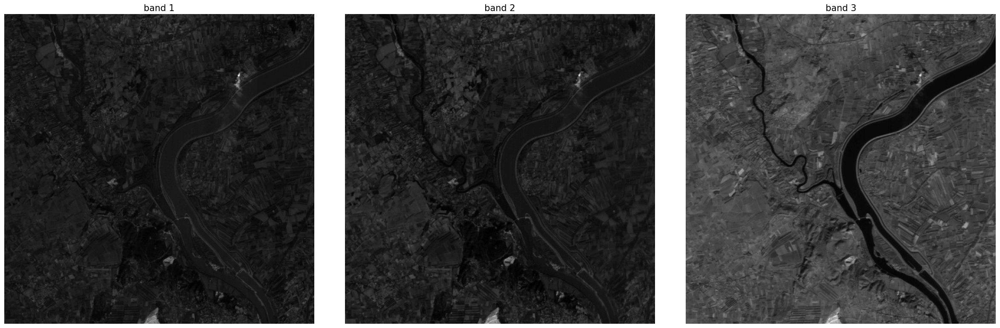

In [36]:
import matplotlib.pyplot as plt
import matplotlib.gridspec as grid

fig,axes = plt.subplots(1,n_bands, figsize=(n_bands*10,12), sharex='all', sharey='all')
fig.subplots_adjust(wspace=0.1, hspace=0.15)
axes = axes.ravel()

for i in range(n_bands):
    # Use floats instead of 8-bit integers for a clearer view of the image
    axes[i].imshow(img[:,:,i] / 255, cmap='gray')
    axes[i].set_title('band '+str(i+1),fontsize=15)
    axes[i].axis('off')

Qu'observez-vous ? 

<div style="background-color:#f0f0fa; padding:10px; border-style: solid; border-color: #99a; color: black">
La première et la deuxième image sont très similaires, mais la deuxième présente un meilleur contraste des rivières avec le terrain. La troisième image illustre clairement ce qui est de l’eau et ce qui est de la terre, mais il est plus difficile d’identifier la végétation.
</div>

Chaque image est un individu: on va d'abord redimensionner les images en vecteurs (pas besoin d'information de structure spatiale !) et on calcule la moyenne et l’écart-type de chacun de ces vecteurs pour les centrer.

In [37]:
# Reshape the image for practicality: 
print("Starting shape: ", img.shape)
img = img.reshape(-1, n_bands)
print("New shape: ", img.shape)
print(img)

Starting shape:  (512, 512, 3)
New shape:  (262144, 3)
[[29. 23. 29.]
 [30. 24. 29.]
 [32. 27. 30.]
 ...
 [39. 28. 35.]
 [35. 23. 37.]
 [26. 17. 37.]]


In [38]:
# Standardization:
means = np.mean(img, axis=0)
stds = np.std(img, axis=0)

img = (img - means) / stds

print(img)

[[-0.33621727  0.31463317  0.12187387]
 [-0.06011854  0.5357671   0.12187387]
 [ 0.49207891  1.19916889  0.26818369]
 ...
 [ 2.42476999  1.42030282  0.99973279]
 [ 1.32037509  0.31463317  1.29235244]
 [-1.16451345 -1.01217042  1.29235244]]


**Vecteurs propres et valeurs propres**: on concatène les vecteurs centrés en une seule matrice dont on calcule la matrice de covariance, qui mesure la relation entre les images. On calcule ensuite les valeurs propres et les vecteurs propres de la matrice de covariance grâce à la fonction ```eig```. On obtient les vecteurs propres, concaténés. 

In [39]:
# Compte the covariance matrix:
cov = np.cov(img, rowvar=False)

# Compute eigenvalues and vectors with eig:
eig_vals, eig_vecs = np.linalg.eig(cov)

# Check that that it worked using the formula:
# A . v = eigenvalues . v

print("A . v\t\t\t\t\teigenvalues . v\t\t\t\tEqual?")
for i in range(n_bands):
  result1 = np.dot(cov, eig_vecs[:, i])
  result2 = eig_vals[i] * eig_vecs[:, i] 
  is_equal = np.allclose(result1, result2)

  print(f"{result1}\t{result2}\t{is_equal}")


A . v					eigenvalues . v				Equal?
[-1.40100567 -1.44503693 -1.0857528 ]	[-1.40100567 -1.44503693 -1.0857528 ]	True
[-0.05498694  0.05913769 -0.00775418]	[-0.05498694  0.05913769 -0.00775418]	True
[-0.25691484 -0.16637967  0.55294714]	[-0.25691484 -0.16637967  0.55294714]	True


In [40]:
# Lets sort the eigenvalues to be able to choose the components by importance:
idx = np.argsort(eig_vals)[::-1]
eig_vals = eig_vals[idx]
eig_vecs = eig_vecs[:, idx]

**Calcul des composantes principales**: On multiplie la matrice concaténée par la matrice des vecteurs propres pour obtenir les composantes principales dans la base des vecteurs propres; ainsi, on va pouvoir trouver le sous-espace optimal pour visualiser les proximités entre les observations, et les corrélations entre les variables. 

In [41]:
# Lets get the components in separate matrices, so we can display them easily:
img_principal = np.dot(img, eig_vecs)

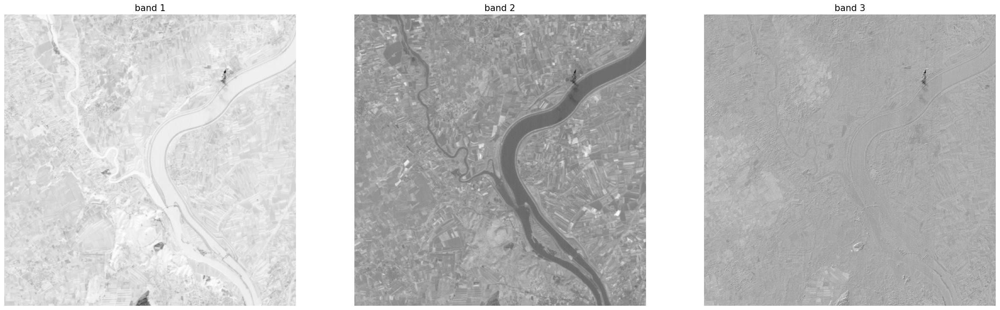

In [42]:
plt.figure(figsize=(n_bands*10, 12))

# Visualize them with imshow: 
for i in range(n_bands):
    plt.subplot(1,n_bands,i+1)
    plt.imshow(img_principal[:,i].reshape(img_shape[0], img_shape[1]), cmap='gray')
    plt.title('band '+str(i+1),fontsize=15)
    plt.axis('off')

*Visuellement, on constate que la première composante détecte un certain nombre d'emplacements précis, ainsi que des limites - la seconde semble détecter l'eau et les champs, et la dernière indique des artefacts verticaux sans doute liés aux capteurs*.

In [43]:
# Compute the percentage of inertia of each component:
inertia = eig_vals / np.sum(eig_vals)

print(inertia)

[0.76228952 0.21066955 0.02704093]


**ACP sur les données LANDSAT sur Tarascon**: Effectuez l’analyse en composantes principales sur les données LANDSAT sur Tarascon. Affichez les images résultats. Calculez le pourcentage d’inertie associé à chaque image et interprétez qualitativement les résultats. Combien d’images faut-il garder pour conserver au moins 95% de l’information ?

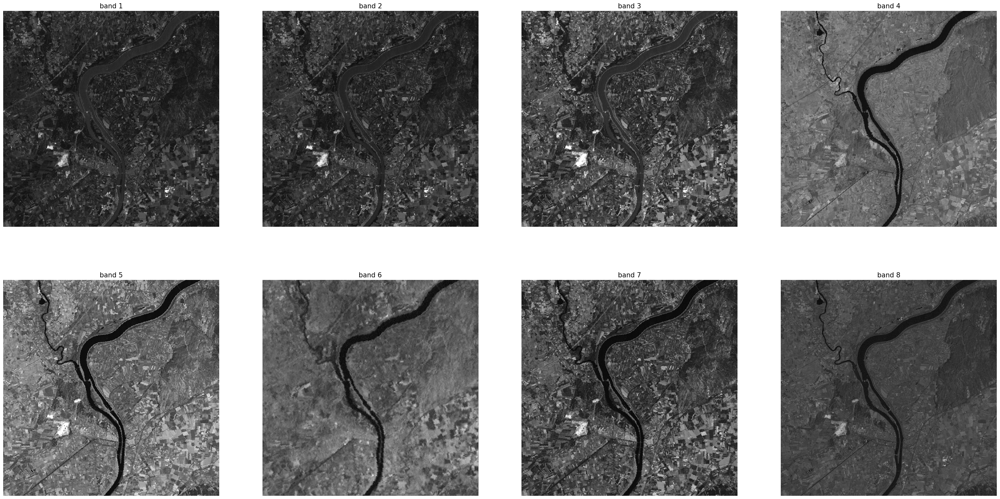

In [44]:
path_img = 'Landsat_Tarascon/landsattarasconC'
n_bands = 8

# Let's take a look at the first channel's size
img = load_image(path_img + '1')
img_shape = img.shape

img = np.zeros((img.shape[0], img.shape[1], n_bands))

# Stacking up images into the numpy array:
for i in range(n_bands):
    img[:, :, i] = load_image(path_img + str(i+1))

# Visualize them with imshow: 
n_rows = 2
plt.figure(figsize=(n_bands*10/n_rows, 20))

for i in range(n_bands):
    plt.subplot(n_rows, n_bands//n_rows, i+1)
    plt.imshow(img[:, :, i] / 255, cmap='gray')
    plt.title('band '+str(i+1),fontsize=15)
    plt.axis('off')

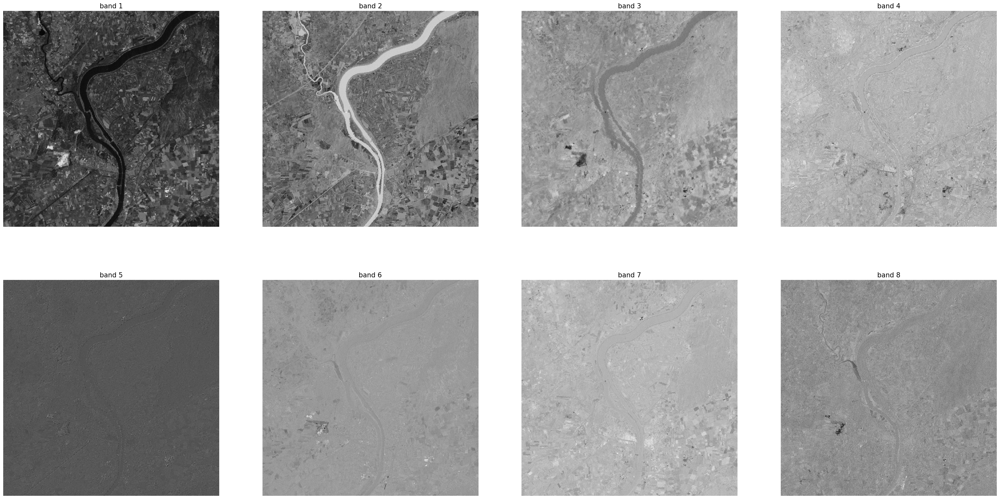

In [45]:
# Reshape the image for practicality: 
img = img.reshape(-1, n_bands)

# Standardization:
means = np.mean(img, axis=0)
stds = np.std(img, axis=0)

img = (img - means) / stds

# Compte the covariance matrix:
cov = np.cov(img, rowvar=False)

# Compute eigenvalues and vectors with eig:
eig_vals, eig_vecs = np.linalg.eig(cov)

# Lets sort the eigenvalues to be able to choose the components by importance:
idx = np.argsort(eig_vals)[::-1]	
eig_vals = eig_vals[idx]
eig_vecs = eig_vecs[:, idx]

# Lets get the components in separate matrices, so we can display them easily:
img_principal = np.dot(img, eig_vecs)

plt.figure(figsize=(n_bands*10/n_rows, 20))

for i in range(n_bands):
    plt.subplot(n_rows,n_bands//n_rows,i+1)
    plt.imshow(img_principal[:,i].reshape(img_shape[0], img_shape[1]), cmap='gray')
    plt.title('band '+str(i+1),fontsize=15)
    plt.axis('off')

In [46]:
# Computing the percentage of inertia of each component:
inertia = eig_vals / np.sum(eig_vals)

print('Intertia:')
print(inertia)

objective = 0.95
num_of_images = 0

while np.sum(inertia[:num_of_images]) < objective:
    num_of_images += 1

print("")
print(f'Number of images to reach {objective*100}% of inertia: {num_of_images}')

Intertia:
[0.68529996 0.16981093 0.09404482 0.02665519 0.01677483 0.00364708
 0.00249158 0.00127561]

Number of images to reach 95.0% of inertia: 4


<div style="background-color:#f0f0fa; padding:10px; border-style: solid; border-color: #99a; color: black">
Pour conserver 95% de l’information, il est nécessaire de conserver 4 images.
</div>

**ACP sur les données LANDSAT sur Kedougou**: Effectuez une ACP sur ce jeu de données. Comparez le résultat avec le dernier capteur défectueux (```CANAL6bruit```) et l'original.

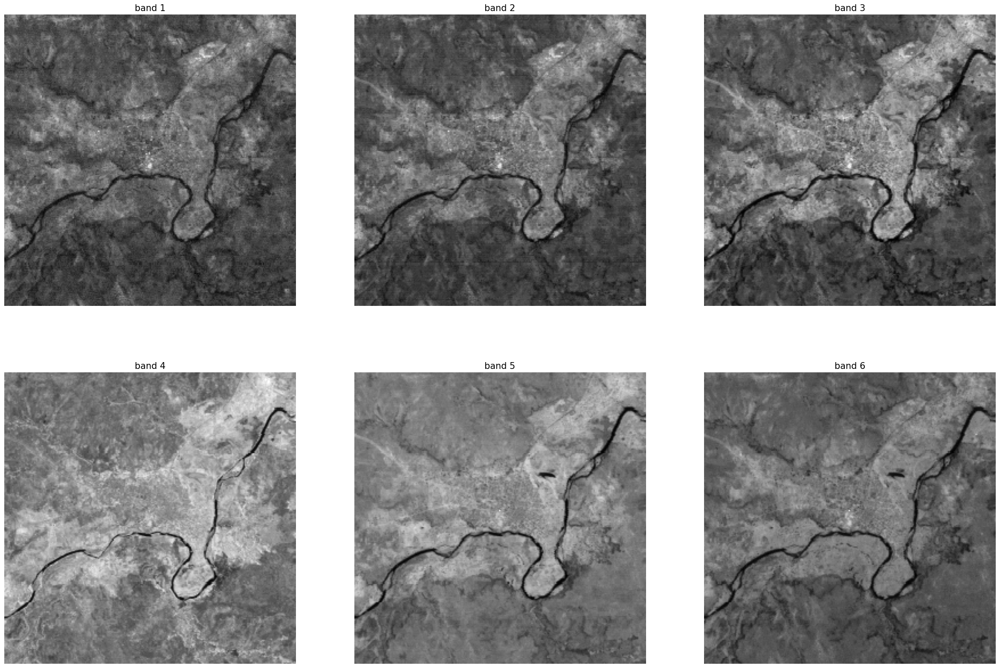

In [47]:
# Capteur normal:
path_img = 'Landsat_Kedougou/landsatKedougouC'
n_bands = 6

# Let's take a look at the first channel's size
img = load_image(path_img + '1')
img_shape = img.shape

img = np.zeros((img_shape[0], img_shape[1], n_bands))

# Stacking up images into the numpy array:
for i in range(n_bands):
    img[:, :, i] = load_image(path_img + str(i+1))

# Visualize them with imshow: 
n_rows = 2
plt.figure(figsize=(n_bands*10/n_rows, 20))

for i in range(n_bands):
    plt.subplot(n_rows, n_bands//n_rows, i+1)
    plt.imshow(img[:, :, i] / 255, cmap='gray')
    plt.title('band '+str(i+1),fontsize=15)
    plt.axis('off')

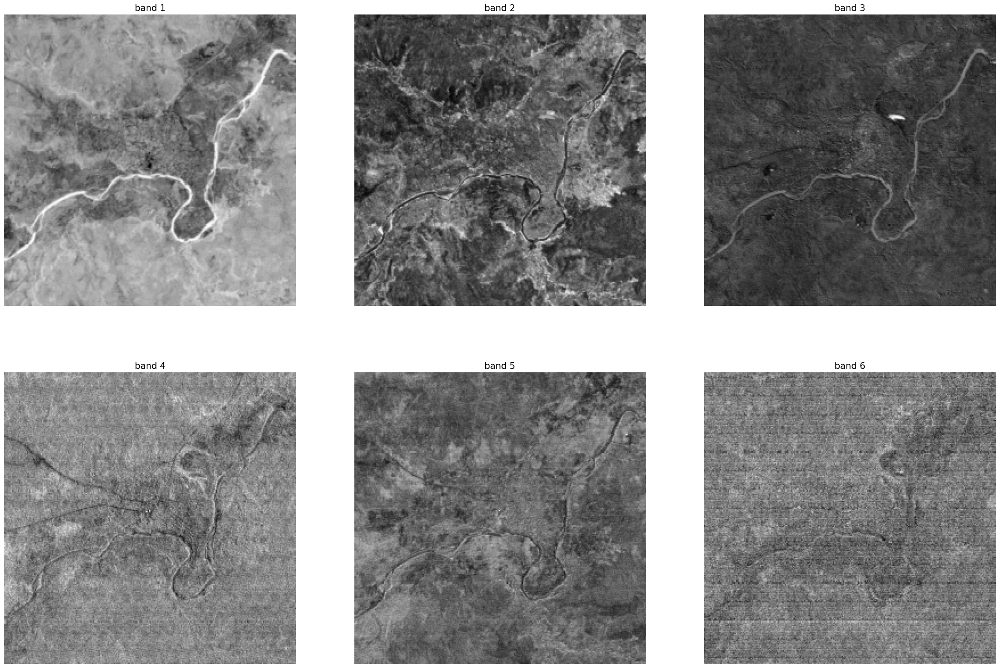

In [48]:
# Reshape the image for practicality: 
img = img.reshape(-1, n_bands)

# Standardization:
means = np.mean(img, axis=0)
stds = np.std(img, axis=0)

img = (img - means) / stds

# Compte the covariance matrix:
cov = np.cov(img, rowvar=False)

# Compute eigenvalues and vectors with eig:
eig_vals, eig_vecs = np.linalg.eig(cov)

# Lets sort the eigenvalues to be able to choose the components by importance:
idx = np.argsort(eig_vals)[::-1]
eig_vals = eig_vals[idx]
eig_vecs = eig_vecs[:, idx]

# Lets get the components in separate matrices, so we can display them easily:
img_principal = np.dot(img, eig_vecs)

plt.figure(figsize=(n_bands*10/n_rows, 20))

for i in range(n_bands):
    plt.subplot(n_rows,n_bands//n_rows,i+1)
    plt.imshow(img_principal[:,i].reshape(img_shape[0], img_shape[1]), cmap='gray')
    plt.title('band '+str(i+1),fontsize=15)
    plt.axis('off')

In [49]:
# Computing the percentage of inertia of each component:
inertia = eig_vals / np.sum(eig_vals)

print('Intertia:')
print(inertia)

objective = 0.95
num_of_images = 0

while np.sum(inertia[:num_of_images]) < objective:
    num_of_images += 1

print("")
print(f'Number of images to reach {objective*100}% of inertia: {num_of_images}')

Intertia:
[0.8206195  0.1065786  0.04214912 0.01383761 0.012708   0.00410717]

Number of images to reach 95.0% of inertia: 3


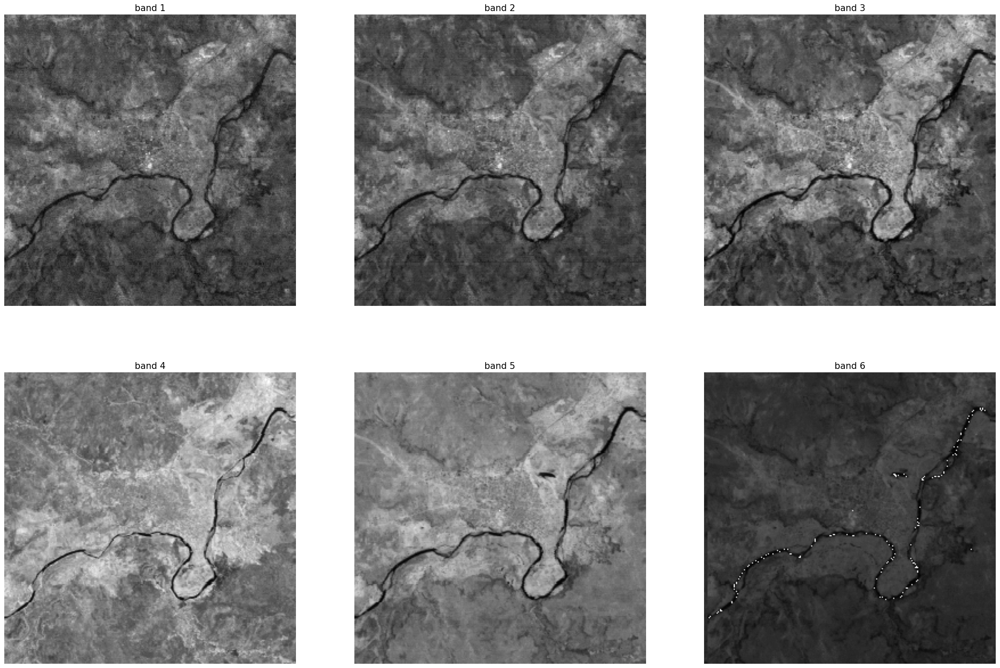

In [50]:
# Avec le bruit: 
img_b = load_image('Landsat_Kedougou/landsatKedougouC6bruit')
n_bands = 6

img = np.zeros((img_shape[0], img_shape[1], n_bands))
# Stacking up images into the numpy array:
for i in range(n_bands):
    if(i != 5):
        img[:, :, i] = load_image(path_img + str(i+1))
    else:
        img[:, :, i] = img_b

# Visualize them with imshow: 
n_rows = 2
plt.figure(figsize=(n_bands*10/n_rows, 20))

for i in range(n_bands):
    plt.subplot(n_rows, n_bands//n_rows, i+1)
    plt.imshow(img[:, :, i] / 255, cmap='gray')
    plt.title('band '+str(i+1),fontsize=15)
    plt.axis('off')

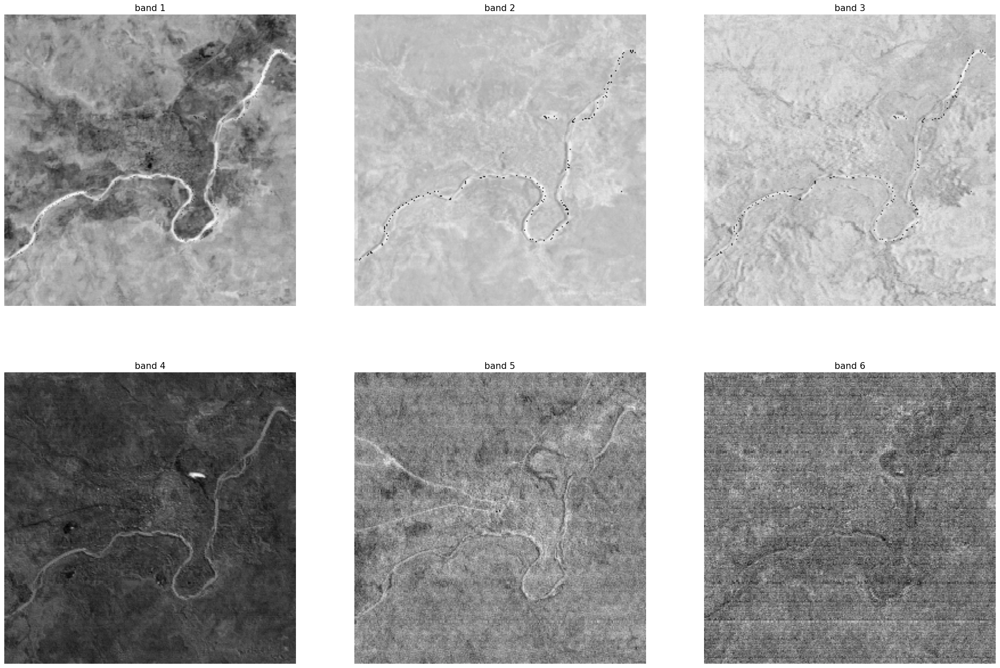

In [51]:
# Reshape the image for practicality: 
img = img.reshape(-1, n_bands)

# Standardization:
means = np.mean(img, axis=0)
stds = np.std(img, axis=0)

img = (img - means) / stds

# Compte the covariance matrix:
cov = np.cov(img, rowvar=False)

# Compute eigenvalues and vectors with eig:
eig_vals, eig_vecs = np.linalg.eig(cov)

# Lets sort the eigenvalues to be able to choose the components by importance:
idx = np.argsort(eig_vals)[::-1]
eig_vals = eig_vals[idx]
eig_vecs = eig_vecs[:, idx]

# Lets get the components in separate matrices, so we can display them easily:
img_principal = np.dot(img, eig_vecs)

plt.figure(figsize=(n_bands*10/n_rows, 20))

for i in range(n_bands):
    plt.subplot(n_rows,n_bands//n_rows,i+1)
    plt.imshow(img_principal[:,i].reshape(img_shape[0], img_shape[1]), cmap='gray')
    plt.title('band '+str(i+1),fontsize=15)
    plt.axis('off')

In [52]:
# Compute the percentage of inertia of each component:
inertia = eig_vals / np.sum(eig_vals)

print('Intertia:')
print(inertia)

objective = 0.95
num_of_images = 0

while np.sum(inertia[:num_of_images]) < objective:
    num_of_images += 1

print("")
print(f'Number of images to reach {objective*100}% of inertia: {num_of_images}')

Intertia:
[0.74345345 0.12236203 0.08137083 0.03492762 0.01373647 0.00414959]

Number of images to reach 95.0% of inertia: 4


<div style="background-color:#f0f0fa; padding:10px; border-style: solid; border-color: #99a; color: black">
Lors de la comparaison de l’application de la méthode PCA en remplaçant le canal 6 par un capteur défectueux, il est évident que l’image résultante est beaucoup plus bruyante et que le bruit se propage à d’autres canaux, pas seulement au canal 6.


Lors de la première tentative d’application du PCA sans le capteur défectueux pour conserver 95% de l’information, seulement 3 images sont nécessaires, tandis qu’avec le bruit, 4 images sont nécessaires.


Ce résultat montre comment un seul canal défectueux peut compliquer considérablement le processus de compression de l’information.
</div>

### K-means

Dans cette partie, on souhaite réaliser un classificateur automatique pour réaliser une segmentation simple d'images : par exemple, pour séparer terres et rivière.
- Tracer l’histogramme canal par canal est instructif !
- La recherche de prototypes nécessite un peu de patience : il faut rechercher sur l’image les coordonnées de points dont on a pu (ou su) voir l’originalité.

**Classification rivière-terre**: Commencez par tester la procédure sur *SPOT* à l'aide des valeurs exemples pour l’eau et sur la terre. 

In [53]:
def histogramme(image):
    hist = np.zeros(256, dtype=np.float32)
    shap = image.shape
    for j in range(shap[0]):
        for i in range(shap[1]):
            valeur = image[j,i]
            hist[int(valeur)] += 1
    return hist

In [54]:
path_img = 'SPOT/cam' 
n_bands = 3 
size = 512 

img = np.zeros((size, size, n_bands))

# Stacking up images into the numpy array:
for i in range(n_bands):
    img[:, :, i] = load_image(path_img + str(i+1))

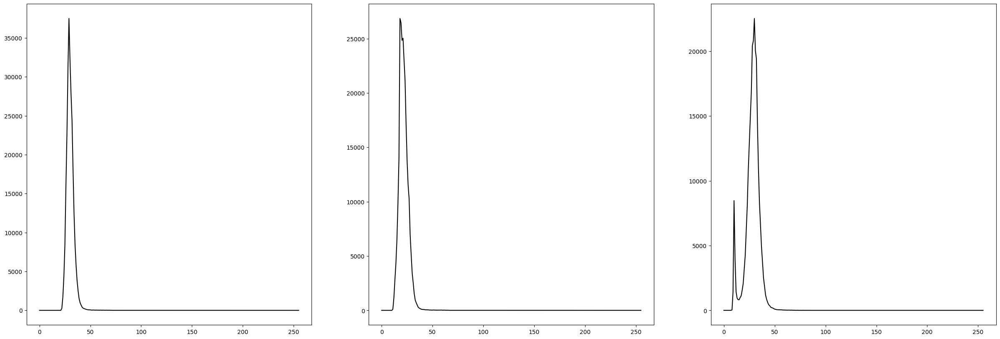

In [55]:
n_rows = 1
plt.figure(figsize=(n_bands*10, 10))

# Use the "histogramme" function to have an intuition of pixel repartition on each image
for i in range(n_bands):
    plt.subplot(n_rows, n_bands//n_rows, i+1)
    plt.plot(histogramme(img[:,:,i]), color='black')

In [56]:
# Lieu du pixel caracteristique de l'eau
p1=[210, 150]
# Lieu du pixel caracteristique de la terre
p2=[50, 50]

Utilisez la classe ```KMeans``` de ```sklearn```. Choississez le nombre de classes avec ```n_clusters``` et les centres initiaux des classes avec ```init```. Enfin, faites tourner l'algorithme sur l'image choisie avec ```.fit()``` et obtenez les classes de chaque pixel avec ```.predict()```. 
N'oubliez pas d'adapter la structure des données: nous n'avons ici qu'un exemple pour la procédure (un seul canal) avec un grand nombre de caractéristiques à classer (les pixels) - choississez les tailles de vos entrées en conséquence ! 

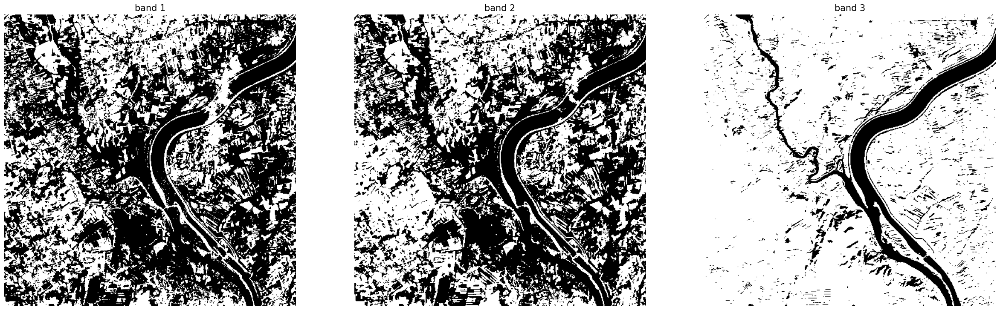

In [57]:
from sklearn.cluster import KMeans

p1_vec = p1[0] * size + p1[1]
p2_vec = p2[0] * size + p2[1]

starting_points = np.array([[p1_vec], [p2_vec]])
img_vec = img.reshape((-1, n_bands))

kmeans = KMeans(n_clusters=2, init=starting_points, n_init=1)
labels = np.zeros((size, size, n_bands))

for i in range(n_bands):
  curr_img = img_vec[:, i].reshape(-1, 1) 
  kmeans.fit(curr_img)

  labels[:, :, i] = kmeans.labels_.reshape(size, size)

plt.figure(figsize=(n_bands*10, 12))
for i in range(n_bands):
    plt.subplot(1, n_bands, i+1)
    plt.imshow(labels[:,:,i], cmap='gray')
    plt.title('band '+str(i+1),fontsize=15)
    plt.axis('off')

  

<div style="background-color:#f0f0fa; padding:10px; border-style: solid; border-color: #99a; color: black">
Après l’application de la méthode K-means, le troisième canal s’est avéré être le meilleur pour segmenter la terre de l’eau avec 2 clusters. Bien que la séparation du canal 3 ait été meilleure, il est toujours possible de voir certaines régions où l’eau et la terre se mélangent pendant le regroupement.
</div>

Faites de même avec les deux autres images. Avec quels canaux pouvez vous obtenir les meilleures segmentation ? Jusqu'à combien de classes ? 

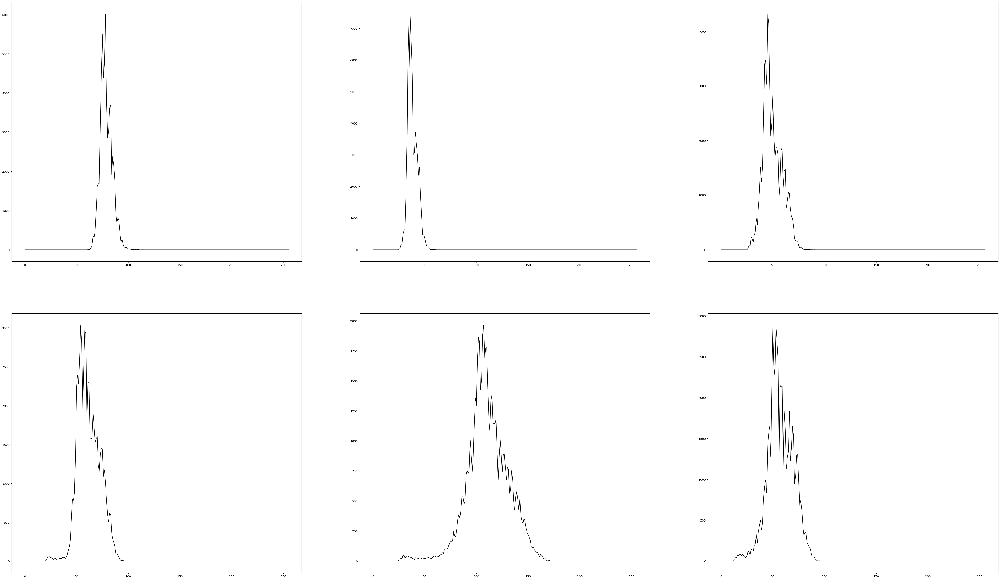

In [58]:
path_img = 'Landsat_Kedougou/landsatkedougouC' 
n_bands = 6 
size = 256

img = np.zeros((size, size, n_bands))

# Stacking up images into the numpy array:
for i in range(n_bands):
    img[:, :, i] = load_image(path_img + str(i+1))


n_rows = 2
plt.figure(figsize=(n_bands*10, 35))

# Use the "histogramme" function to have an intuition of pixel repartition on each image
for i in range(n_bands):
    plt.subplot(n_rows, n_bands//n_rows, i+1)
    plt.plot(histogramme(img[:,:,i]), color='black')

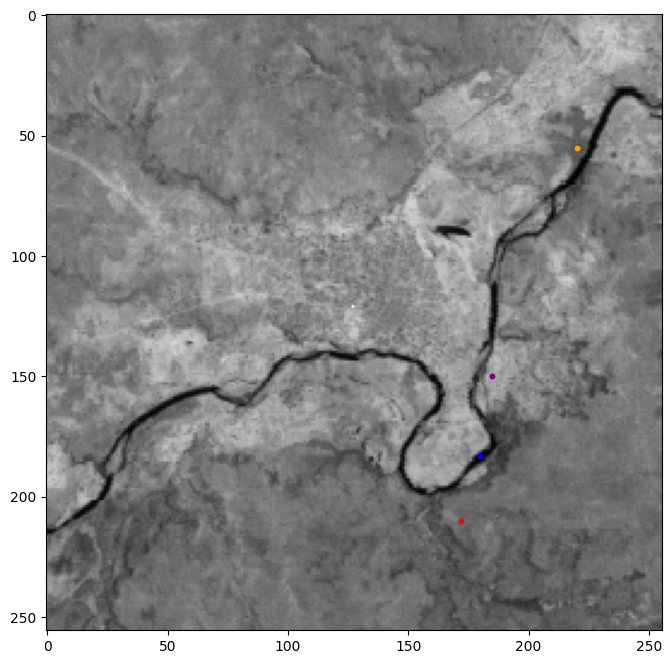

In [59]:
# Fiding initial points for the water and land segmentation
plt.figure(figsize=(8, 8))
plt.imshow(img[:, :, 4], cmap='gray')

# Lieu du pixel caracteristique de l'eau
p1 = [180, 183]
# Lieu du pixel caracteristique de la terre
p2 = [172, 210]
# Lieu du pixel caracteristique de la terre 2
p3 = [185, 150]
# Lieu du pixel caracteristique de la terre 3
p4 = [220, 55]


plt.scatter(p1[0], p1[1], color='blue', s=10)
plt.scatter(p2[0], p2[1], color='red', s=10)
plt.scatter(p3[0], p3[1], color='purple', s=10)
plt.scatter(p4[0], p4[1], color='orange', s=10)

p1_vec = p1[0] * size + p1[1]
p2_vec = p2[0] * size + p2[1]
p3_vec = p3[0] * size + p3[1]
p4_vec = p4[0] * size + p4[1]

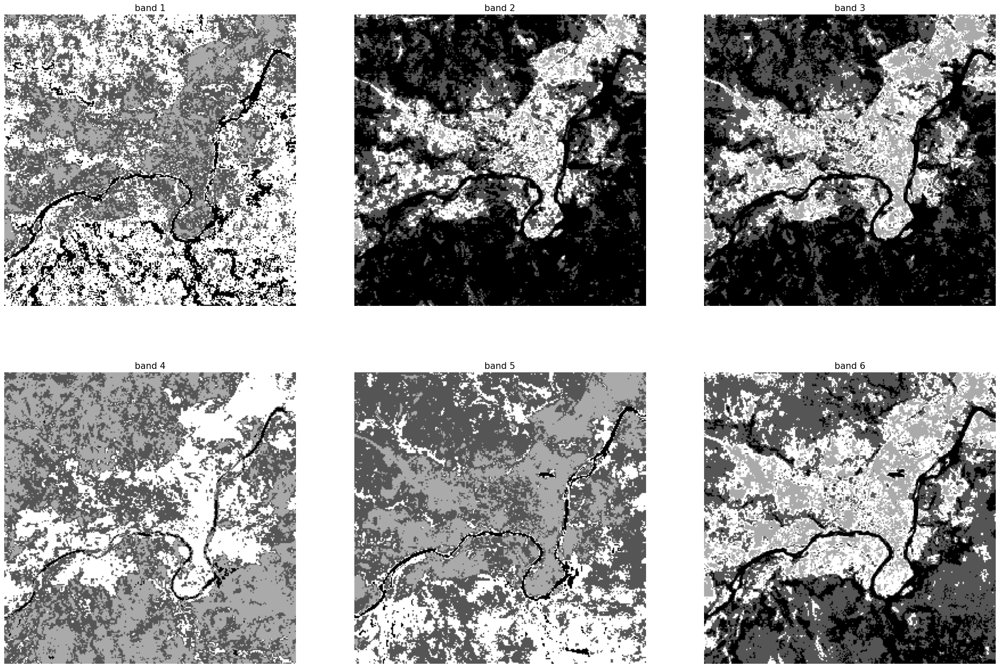

In [60]:
starting_points = np.array([[p1_vec], [p2_vec], [p3_vec], [p4_vec]])
img_vec = img.reshape((-1, n_bands))

kmeans = KMeans(n_clusters=4, init=starting_points, n_init=1)
labels = np.zeros((size, size, n_bands))

img_vec = img.reshape((-1, n_bands))

for i in range(n_bands):
  curr_img = img_vec[:, i].reshape(-1, 1) 
  kmeans.fit(curr_img)

  labels[:, :, i] = kmeans.labels_.reshape(size, size)

n_rows = 2
plt.figure(figsize=(n_bands*10//n_rows, 20))
for i in range(n_bands):
    plt.subplot(n_rows, n_bands//n_rows, i+1)
    plt.imshow(labels[:,:,i], cmap='gray')
    plt.title('band '+str(i+1),fontsize=15)
    plt.axis('off')

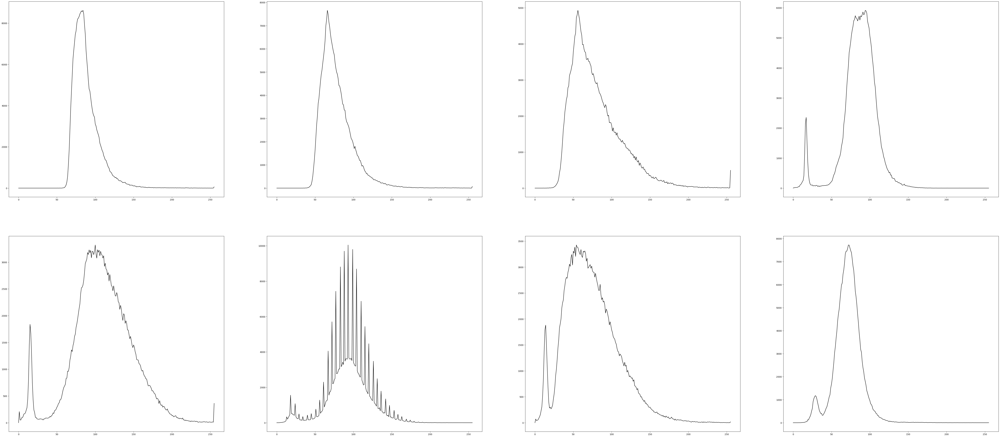

In [61]:
path_img = 'Landsat_Tarascon/landsattarasconC' 
n_bands = 8 
size = 512

img = np.zeros((size, size, n_bands))

# Stacking up images into the numpy array:
for i in range(n_bands):
    img[:, :, i] = load_image(path_img + str(i+1))


n_rows = 2
plt.figure(figsize=(n_bands*10, 35))

# Use the "histogramme" function to have an intuition of pixel repartition on each image
for i in range(n_bands):
    plt.subplot(n_rows, n_bands//n_rows, i+1)
    plt.plot(histogramme(img[:,:,i]), color='black')

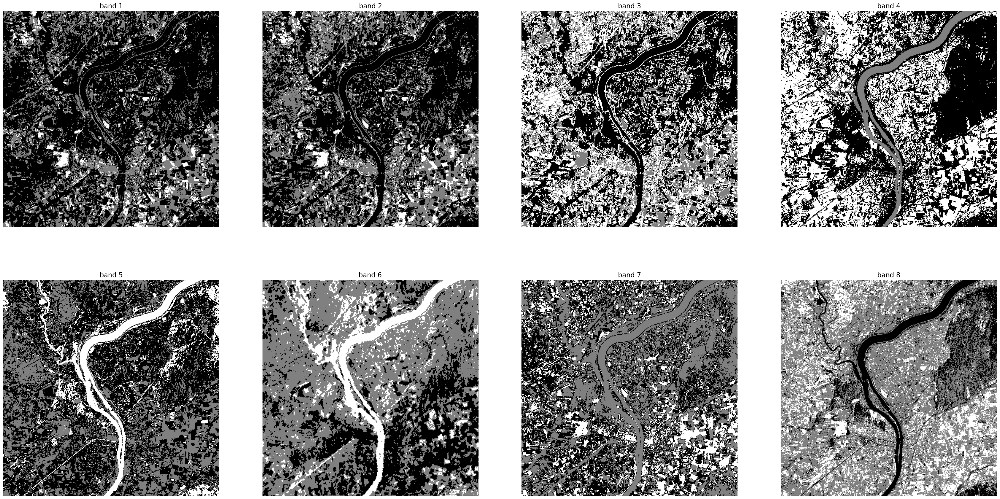

In [62]:
kmeans = KMeans(n_clusters=3, n_init=10)
labels = np.zeros((size, size, n_bands))

img_vec = img.reshape((-1, n_bands))

for i in range(n_bands):
  curr_img = img_vec[:, i].reshape(-1, 1) 
  kmeans.fit(curr_img)

  labels[:, :, i] = kmeans.labels_.reshape(size, size)

n_rows = 2
plt.figure(figsize=(n_bands*10//n_rows, 20))
for i in range(n_bands):
    plt.subplot(n_rows, n_bands//n_rows, i+1)
    plt.imshow(labels[:,:,i], cmap='gray')
    plt.title('band '+str(i+1),fontsize=15)
    plt.axis('off')

<div style="background-color:#f0f0fa; padding:10px; border-style: solid; border-color: #99a; color: black">
En ce qui concerne l’image Landsat_Kedougou, la meilleure segmentation avec la méthode K-means a été obtenue avec 4 clusters. Les canaux les plus performants ont été les 1, 4 et 5, avec lesquels il a été possible d’obtenir une meilleure segmentation entre l’eau et la terre, bien que celle-ci ne soit pas parfaite. Pour obtenir ce résultat, 4 points initiaux fixes ont été choisis : 1 représentant l’eau et les 3 autres représentant différentes nuances de la terre.

<br/>

Quant à l’image Landsat_Tarascon, la meilleure segmentation a été obtenue avec 3 clusters et il n’a pas été nécessaire de définir des points initiaux ; le processus a été effectué de manière stochastique par la bibliothèque elle-même. Les bandes avec les meilleures performances ont été les 4, 5 et 6, qui ont visuellement présenté une bonne distinction entre la terre et l’eau, bien qu’elles ne soient pas encore parfaites.
</div>